In [120]:
import numpy as np
import pandas as pd
import plotly.express as px
from plotly.subplots import make_subplots
from  scipy.stats import zscore
import plotly.io as pio

pd.set_option('display.max_rows', 500)

In [93]:
df = pd.read_csv('data/final.csv')

In [94]:
df['Date'] = pd.to_datetime(df['Date'])
df['Month'] = df['Date'].dt.to_period('M').dt.to_timestamp()
df['DateSTR'] = df['Date'].astype(str)

In [95]:
# Group some of the companies because they have very little activity, or were consolodated.
df['Operator'] = np.where(df['Company'] == 'Billy Bey', 'NY Waterway', df['Company'])
df['Operator'] = np.where(df['Operator'].str.contains('NY Waterway'), 'NY Waterway', df['Operator'])
df['Operator'] = np.where(df['Operator'] == 'Water Tours', 'Other', df['Operator'])
df['Operator'] = np.where(df['Operator'] == 'HMS', 'Other', df['Operator'])
df['Operator'] = np.where(df['Operator'] == 'Baseball', 'Other', df['Operator'])

In [96]:
df['z_score'] = df.groupby('Operator')['Rides'].transform(lambda x: zscore(x))

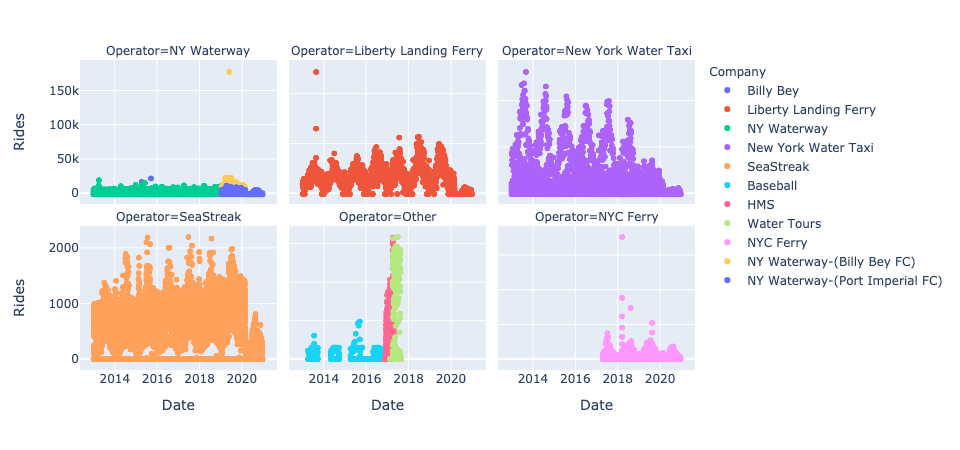

In [97]:
df_plot = df[['Operator', 'Company', 'Date', 'DateSTR', 'Rides']]

fig = px.scatter(df_plot, x="Date", y="Rides", color="Company", facet_col="Operator", 
                 facet_col_wrap=3, custom_data=['DateSTR'])
fig.update_yaxes(matches=None)
fig.update_traces(
    hovertemplate="<br>".join([
        "Date: %{customdata[0]}",
        "Rides: %{y}",
    ])
)
fig.show()

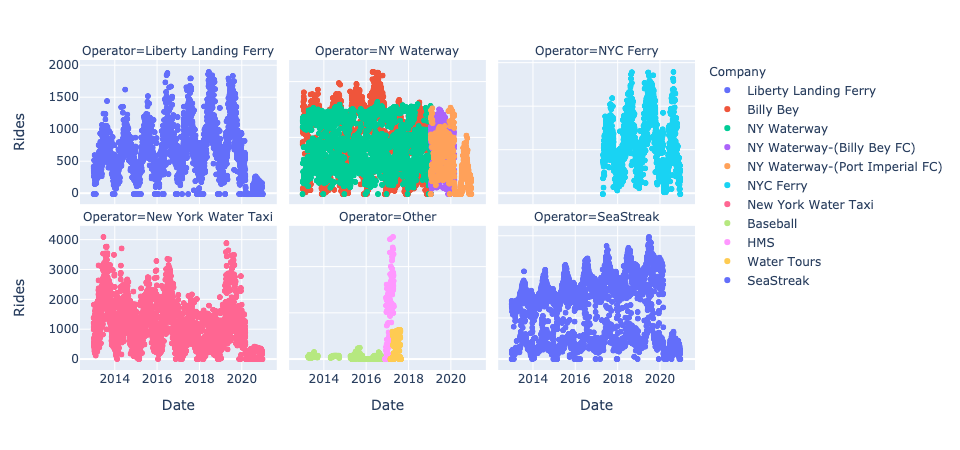

In [98]:
df_plot = df[df['z_score'] <= 3]
df_plot = df_plot.groupby(['Operator', 'Company', 'Date', 'DateSTR']).agg({'Rides':'sum'}).reset_index()



fig = px.scatter(df_plot, x="Date", y="Rides", color="Company", facet_col="Operator", 
                 facet_col_wrap=3, custom_data=['DateSTR'])
fig.update_yaxes(matches=None)
fig.update_traces(
    hovertemplate="<br>".join([
        "Date: %{customdata[0]}",
        "Rides: %{y}",
    ])
)
fig.show()

In [99]:
df = df[df['z_score'] <= 3]

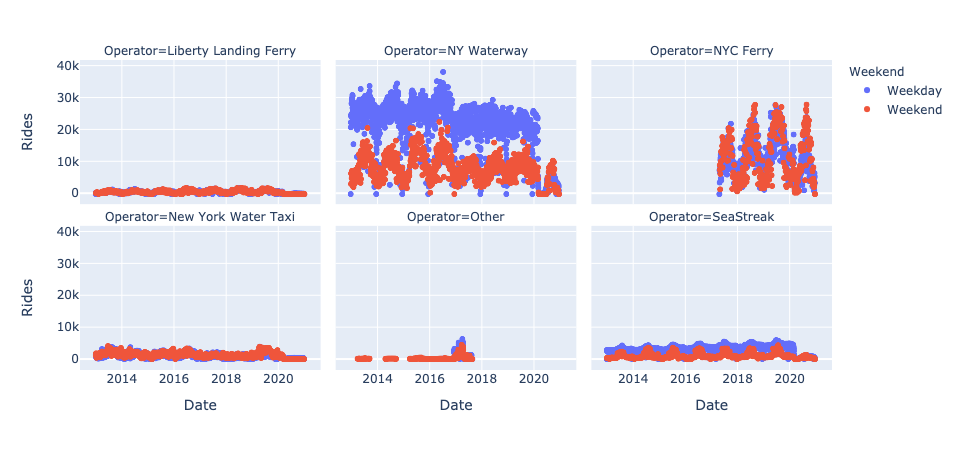

In [115]:
df_grouped = df.groupby(['Operator', 'Date', 'DateSTR', 'Weekend']).agg({'Rides':'sum'}).reset_index()

fig = px.scatter(df_grouped, x="Date", y="Rides", facet_col="Operator", color='Weekend',
                 facet_col_wrap=3, custom_data=['DateSTR'])
#fig.update_yaxes(matches=None)
fig.update_traces(
    hovertemplate="<br>".join([
        "Date: %{customdata[0]}",
        "Rides: %{y}",
    ])
)
fig.show()

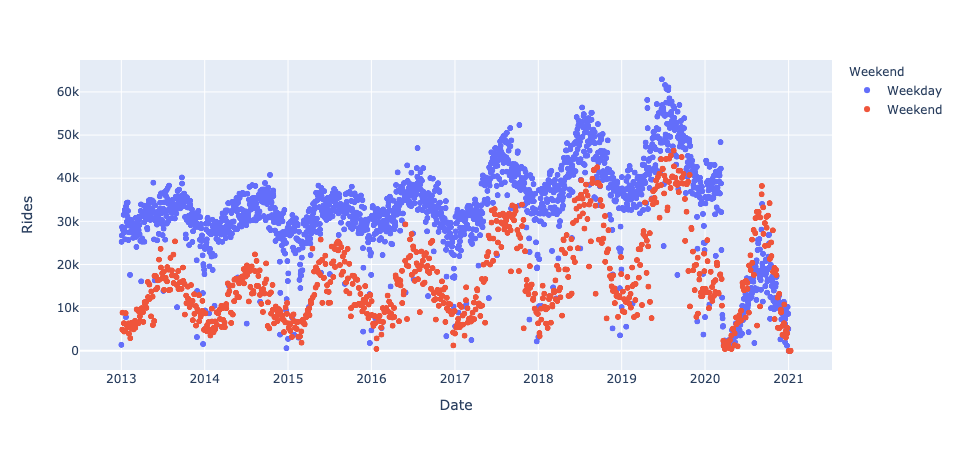

In [101]:
df_grouped = df.groupby(['Date', 'DateSTR', 'Day', 'Weekend']).agg({'Rides':'sum'}).reset_index()


fig = px.scatter(df_grouped, x="Date", y="Rides", color='Weekend', custom_data=['DateSTR'])
fig.update_yaxes(matches=None)
fig.update_traces(
    hovertemplate="<br>".join([
        "Date: %{customdata[0]}",
        "Rides: %{y}",
    ])
)
fig.show()

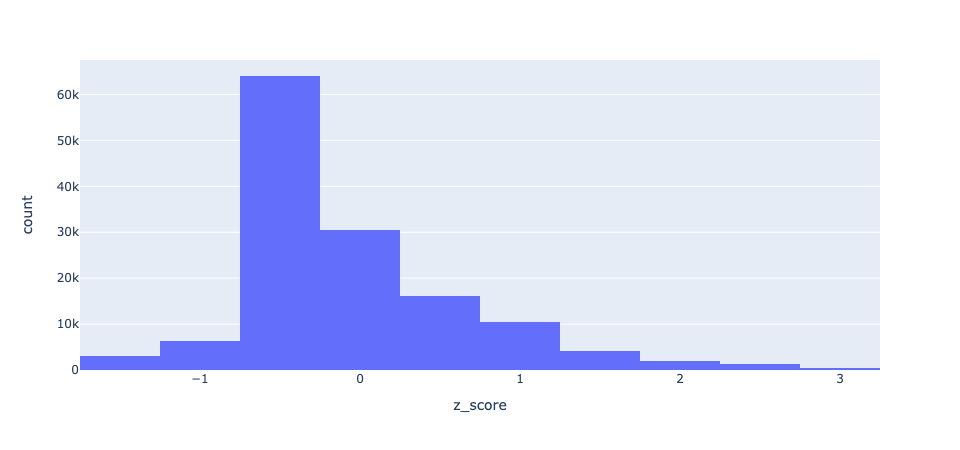

In [102]:
fig = px.histogram(df, x='z_score', nbins=15)
fig.show()

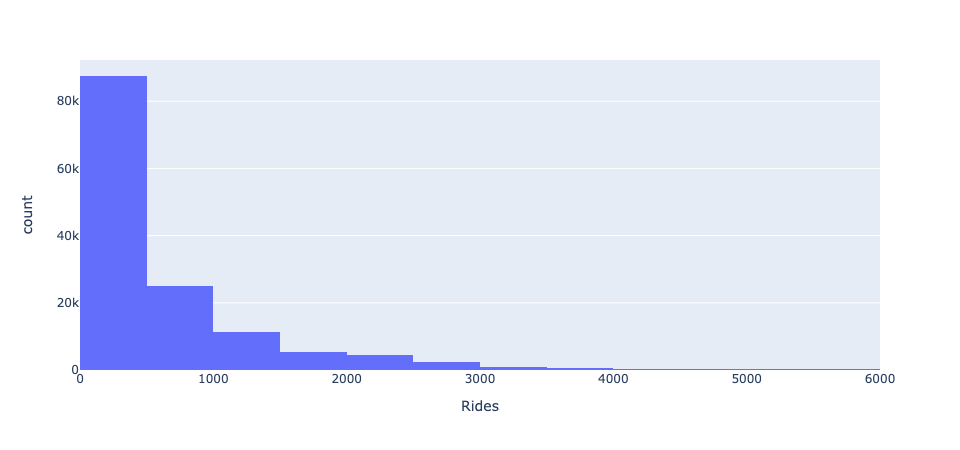

In [103]:
fig = px.histogram(df, x="Rides", nbins=20)
fig.update_traces(xbins=dict( # bins used for histogram
        start=0.0,
        end=6000.0
    ))
fig.show()

In [104]:
df.groupby('Operator')['Rides'].describe()

,count,mean,std,min,25%,50%,75%,max
Operator,,,,,,,,
Liberty Landing Ferry,2915.0,651.202744,399.283044,0.0,395.5,613.0,878.0,1910.0
NY Waterway,61632.0,833.183249,1073.007543,0.0,0.0,401.0,1229.0,5741.0
NYC Ferry,39099.0,407.371365,413.944524,0.0,99.0,289.0,575.0,2123.0
New York Water Taxi,20932.0,152.571765,207.849203,0.0,0.0,78.0,221.0,1367.0
Other,2253.0,192.942743,268.289279,0.0,0.0,61.0,303.0,1181.0
SeaStreak,11992.0,622.624583,455.555270,0.0,156.0,688.0,977.0,1984.0


In [105]:
df['Rides'].describe()

count    138823.000000
mean        578.230302
std         809.599817
min           0.000000
25%           0.000000
50%         292.000000
75%         794.000000
max        5741.000000
Name: Rides, dtype: float64

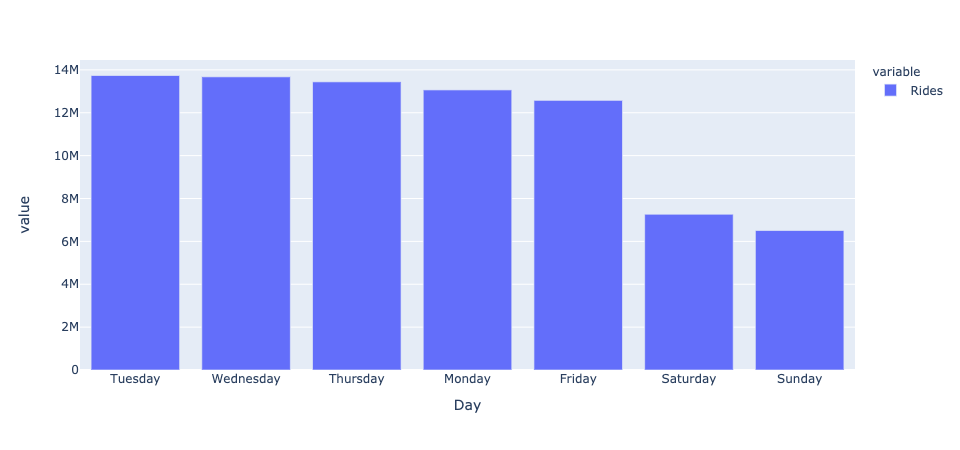

In [106]:
grouped = df.groupby('Day')['Rides'].sum()
#grouped_sorted = grouped.sort_values('Rides', ascending=True).reset_index()


fig = px.bar(grouped)
fig.update_layout(xaxis={'categoryorder':'total descending'})
fig.show()

In [107]:
weather = pd.read_csv('data/open_weather_map_data.csv')

In [108]:
weather.columns

Index(['dt', 'dt_iso', 'timezone', 'city_name', 'lat', 'lon', 'temp',
       'feels_like', 'temp_min', 'temp_max', 'pressure', 'sea_level',
       'grnd_level', 'humidity', 'wind_speed', 'wind_deg', 'rain_1h',
       'rain_3h', 'snow_1h', 'snow_3h', 'clouds_all', 'weather_id',
       'weather_main', 'weather_description', 'weather_icon'],
      dtype='object')

In [109]:
weather['date'] = weather['dt_iso'].str[:10]

In [110]:
grouped_weather = weather.groupby('date').agg({'temp': 'mean', 'feels_like': 'mean', 'temp_min': 'min',
                                              'temp_max': 'max', 'humidity': 'mean', 'rain_1h': 'sum', 'snow_1h': 'sum',
                                              'clouds_all': 'mean'}).reset_index()

# Convert measurments fro mm to inches
grouped_weather['rain_1h'] = grouped_weather['rain_1h'] * 0.0393701
grouped_weather['snow_1h'] = grouped_weather['snow_1h'] * 0.0393701


grouped_weather.columns = ['date', 'temp_avg', 'feels_like_avg', 'temp_min', 'temp_max', 'humidity_avg', 'rain_in',
                          'snow_in', 'cloud_pct_avg']
grouped_weather

,date,temp_avg,feels_like_avg,temp_min,temp_max,humidity_avg,rain_in,snow_in,cloud_pct_avg
0,1979-01-01,49.437742,42.138387,42.81,59.00,91.935484,0.448819,0.0,90.000000
1,1979-01-02,54.477027,47.622973,46.94,62.06,93.135135,1.944883,0.0,90.000000
2,1979-01-03,31.235556,15.562593,15.98,55.94,66.111111,0.362205,0.0,44.333333
3,1979-01-04,18.990417,3.473333,12.02,29.25,49.666667,0.000000,0.0,5.875000
4,1979-01-05,25.114167,11.890000,19.45,28.94,46.666667,0.000000,0.0,32.583333
...,...,...,...,...,...,...,...,...,...
15442,2021-04-12,47.131613,38.957097,44.01,51.80,86.741935,0.549213,0.0,90.000000
15443,2021-04-13,51.090800,45.613200,41.00,66.20,71.240000,0.403544,0.0,60.920000
15444,2021-04-14,56.465000,51.939583,46.00,71.60,66.625000,0.000000,0.0,25.083333
15445,2021-04-15,54.433077,51.519615,47.86,62.60,86.115385,0.769292,0.0,90.000000


In [111]:
grouped_ridership = df[['DateSTR', 'Rides']].groupby('DateSTR').sum()
daily_ridership_weather = grouped_ridership.merge(grouped_weather, how='left', left_on='DateSTR', right_on='date')

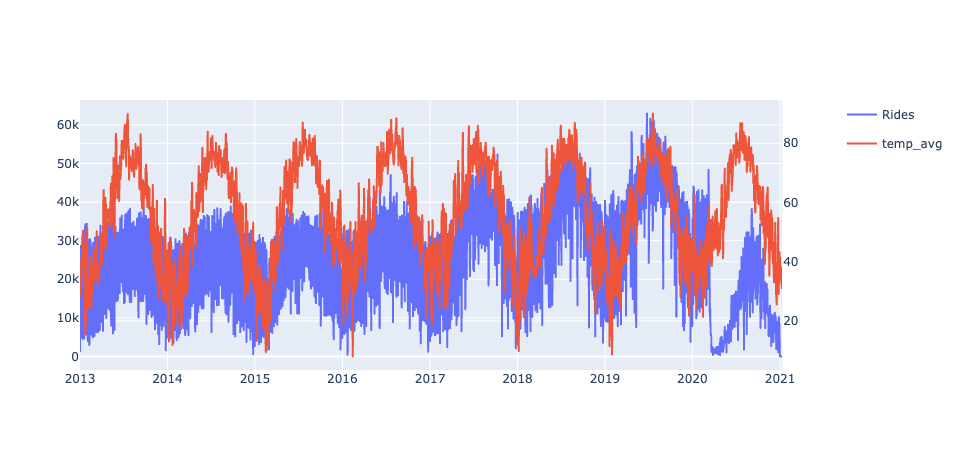

In [122]:
#ridership_subset = daily_ridership_weather[daily_ridership_weather['date'].str[:4] == '2020']
ridership_subset = daily_ridership_weather

fig = px.line(ridership_subset, x='date', y=['Rides'])
fig2 = px.line(ridership_subset, x='date', y=['temp_avg'])

subfig = make_subplots(specs=[[{"secondary_y": True}]])

fig2.update_traces(yaxis="y2")
subfig.add_traces(fig.data + fig2.data)

subfig.for_each_trace(lambda t: t.update(line=dict(color=t.marker.color)))
pio.write_html(subfig, file="index.html", auto_open=True)
subfig.show()